<a href="https://colab.research.google.com/github/Kusakawama/MADS_CNN/blob/main/Copy_of_ModelEVALPOC_TCAV.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Masterthesis: Exploring the Use of Explainable AI for Decision Making in the Context of Disaster Risk Management for Wildfires. **POC: TCAV for wildfire occurence classification**
---
Sarah S. Ziegenhagen


## Imports and installments

In [1]:
# Installments
! pip install -q kaggle
! pip install captum
! pip install torch torchvision
! pip install tensorboard

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 6.0 MB/s eta 0:00:00


In [2]:
# General imports
import numpy as np
import os, glob
import matplotlib.pyplot as plt
from scipy.stats import ttest_ind
from google.colab import files
import cv2
import random
import shutil
from PIL import Image
from sklearn.metrics import confusion_matrix
import itertools

# Pytorch imports
import torch
#import torchvision
from torch.utils.data import IterableDataset, DataLoader
import torch.nn as nn
import torchvision.models as models
import torch.optim as optim
from torchvision import datasets, models, transforms
from torchvision.datasets import ImageFolder
from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter()

# Captum imports
from captum.attr import LayerGradientXActivation, LayerIntegratedGradients
from captum.concept import TCAV
from captum.concept import Concept
from captum.concept._utils.data_iterator import dataset_to_dataloader, CustomIterableDataset
from captum.concept._utils.common import concepts_to_str

## Setup

In [ ]:
'''# Check if CUDA (GPU) is available
print("CUDA available:", torch.cuda.is_available())

# Check the device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)'''

'# Check if CUDA (GPU) is available\nprint("CUDA available:", torch.cuda.is_available())\n\n# Check the device\ndevice = torch.device("cuda" if torch.cuda.is_available() else "cpu")\nprint("Using device:", device)'

In [3]:
# Check the device - defaults to CPU. TCAV setup does not work on GPU.
# Used Setup: Google Colab T4 V2
device = torch.device("cpu")
print("Using device:", device)

Using device: cpu


# Wildfire Occurence Classification Model

## Wildfire Data Loading and Preprocessing

In [4]:
# connect to the kaggle API to load the datasets
files.upload()
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/
! chmod 600 ~/.kaggle/kaggle.json
! kaggle datasets list

Saving kaggle.json to kaggle.json
ref                                                                  title                                           size  lastUpdated          downloadCount  voteCount  usabilityRating  
-------------------------------------------------------------------  ---------------------------------------------  -----  -------------------  -------------  ---------  ---------------  
berkayalan/paris-2024-olympics-medals                                Paris 2024 Olympics Medals                       1KB  2024-08-14 11:02:45           5194         96  1.0              
haseebindata/student-performance-predictions                         Student Performance Predictions                  9KB  2024-08-17 06:57:57           5651        120  0.9411765        
cvergnolle/gold-price-and-relevant-metrics                           Gold Price & Relevant Metrics                   36KB  2024-08-13 22:08:02           1370         21  1.0              
uom190346a/sleep-and-healt

In [5]:
# download and unzip the wildfire occurence dataset
! kaggle datasets download abdelghaniaaba/wildfire-prediction-dataset
! mkdir -p wildfire-prediction-dataset
! unzip wildfire-prediction-dataset.zip -d wildfire-prediction-dataset

Streaming output truncated to the last 5000 lines.
  inflating: wildfire-prediction-dataset/valid/nowildfire/-73.465183,45.443641.jpg  
  inflating: wildfire-prediction-dataset/valid/nowildfire/-73.465388,45.584881.jpg  
  inflating: wildfire-prediction-dataset/valid/nowildfire/-73.469451,45.480331.jpg  
  inflating: wildfire-prediction-dataset/valid/nowildfire/-73.471252,45.51974.jpg  
  inflating: wildfire-prediction-dataset/valid/nowildfire/-73.472693,45.427766.jpg  
  inflating: wildfire-prediction-dataset/valid/nowildfire/-73.473015,45.435254.jpg  
  inflating: wildfire-prediction-dataset/valid/nowildfire/-73.475051,45.56612.jpg  
  inflating: wildfire-prediction-dataset/valid/nowildfire/-73.477079,45.597274.jpg  
  inflating: wildfire-prediction-dataset/valid/nowildfire/-73.478813,45.555686.jpg  
  inflating: wildfire-prediction-dataset/valid/nowildfire/-73.479478,45.524618.jpg  
  inflating: wildfire-prediction-dataset/valid/nowildfire/-73.480135,45.528248.jpg  
  inflating: wil

In [6]:
# download and unzip the landuse-concept dataset
! kaggle datasets download apollo2506/landuse-scene-classification
! mkdir -p concept-dataset
! unzip landuse-scene-classification.zip -d concept-dataset

Streaming output truncated to the last 5000 lines.
  inflating: concept-dataset/images_train_test_val/train/mediumresidential/mediumresidential_000365.png  
  inflating: concept-dataset/images_train_test_val/train/mediumresidential/mediumresidential_000366.png  
  inflating: concept-dataset/images_train_test_val/train/mediumresidential/mediumresidential_000367.png  
  inflating: concept-dataset/images_train_test_val/train/mediumresidential/mediumresidential_000368.png  
  inflating: concept-dataset/images_train_test_val/train/mediumresidential/mediumresidential_000369.png  
  inflating: concept-dataset/images_train_test_val/train/mediumresidential/mediumresidential_000371.png  
  inflating: concept-dataset/images_train_test_val/train/mediumresidential/mediumresidential_000372.png  
  inflating: concept-dataset/images_train_test_val/train/mediumresidential/mediumresidential_000374.png  
  inflating: concept-dataset/images_train_test_val/train/mediumresidential/mediumresidential_000376.p

In [7]:
# Investigate the dataset

# Dictionary to hold the counts of images and their sizes for each subfolder
wildfire_dir = '/content/wildfire-prediction-dataset'
folder_image_count = {}
image_sizes = {}

# List of subfolders to investigate
subfolders = ['train', 'test', 'valid']

# Iterate through each subfolder
for subfolder in subfolders:
    subfolder_path = os.path.join(wildfire_dir, subfolder)
    folder_image_count[subfolder] = 0

    # Iterate through each folder (concept) within the subfolder
    for folder_name in os.listdir(subfolder_path):
        folder_path = os.path.join(subfolder_path, folder_name)
        if os.path.isdir(folder_path):
            for image_name in os.listdir(folder_path):
                image_path = os.path.join(folder_path, image_name)
                try:
                    with Image.open(image_path) as img:
                        img_size = img.size
                        folder_image_count[subfolder] += 1
                        if img_size not in image_sizes:
                            image_sizes[img_size] = 0
                        image_sizes[img_size] += 1
                except Exception as e:
                    print(f"Error loading image {image_path} in {subfolder}/{folder_name}: {e}")

# Print the results
print("Image counts by subfolder:", folder_image_count)
print("Image sizes frequency:", image_sizes)

Image counts by subfolder: {'train': 30250, 'test': 6300, 'valid': 6300}
Image sizes frequency: {(350, 350): 42850}


In [8]:
# Define the paths to the wildfire data
train_dir = '/content/wildfire-prediction-dataset/train'
val_dir = '/content/wildfire-prediction-dataset/valid'
test_dir = '/content/wildfire-prediction-dataset/test'

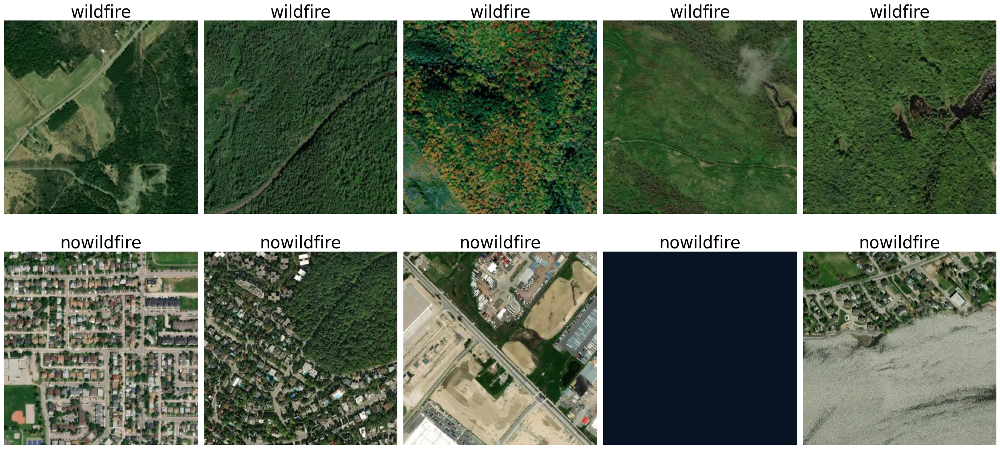

In [9]:
# Define the class names and number of images to display per class
class_names = ['wildfire', 'nowildfire']
image_count = 5  # Number of images to display per class

# Create the subplots with adjusted spacing
fig, axs = plt.subplots(2, image_count, figsize=(25, 12))  # Increase the figsize height

# Adjust the vertical space between the rows
plt.subplots_adjust(hspace=0.3)  # Increase hspace to add more space between rows

# Loop through each class and display images
for row, class_name in enumerate(class_names):
    class_folder = os.path.join(train_dir, class_name)
    image_files = glob.glob(os.path.join(class_folder, '*.*'))[:image_count]

    for col, image_file in enumerate(image_files):
        img = plt.imread(image_file)
        axs[row, col].imshow(img)
        axs[row, col].axis('off')
        axs[row, col].set_title(class_name, fontsize=30)

plt.tight_layout()
plt.show()

In [10]:
# Define a data loader using CV2
def cv2_loader(path):
    img = cv2.imread(path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return Image.fromarray(img)

In [11]:
# Set the data transformations to ensure consistent formats and compatibility
# Std. and mean from imagenet data used as this is what the model is originaly trained on
data_transforms = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])


In [ ]:
'''# Initialize the data
train_dataset = ImageFolder(root=train_dir, transform=data_transforms, loader=cv2_loader)
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
# get the mean and std to normalize the images
wf_mean = torch.zeros(3)
wf_std = torch.zeros(3)

for images, _ in train_loader:
    images = images.view(images.size(0), images.size(1), -1)
    wf_mean += images.mean(2).sum(0)
    wf_std += images.std(2).sum(0)

wf_mean /= len(train_loader.dataset)
wf_std /= len(train_loader.dataset)

print(f'Mean: {wf_mean}')
print(f'Std: {wf_std}')'''

Mean: tensor([0.2968, 0.3484, 0.2530])
Std: tensor([0.1354, 0.1167, 0.1136])


In [ ]:
'''# normalize the images
class_transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(
        mean=wf_mean,
        std=wf_std
    ),
])'''

In [12]:
# Load the train, test and validation datasets applying the defined transformations

# Load training data
train_dataset = ImageFolder(root=train_dir, transform=data_transforms, loader=cv2_loader)
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)

# Load validation data
val_dataset = ImageFolder(root=val_dir, transform=data_transforms, loader=cv2_loader)
val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)

# Load test data
test_dataset = ImageFolder(root=test_dir, transform=data_transforms, loader=cv2_loader)
test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

## Model Training
A ResNet50 with Imagent weights is initialized and fined tuned for the purpose of wildfirce occurence prediction in the form of a binary classification.

Moving forward, this model was saved and loaded for analysis to be mindful of computational resources and ensure consistent results.

In [13]:
# Initiate the pretrained ResNet50
model = models.resnet50(pretrained=True)

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 207MB/s]


In [14]:
# Define the fully connected layers for the binary classification (2 classes: wildifre, nowildfire)
model.fc = nn.Linear(model.fc.in_features, 2)
#model = model.to('cuda' if torch.cuda.is_available() else 'cpu')

In [15]:
# Define hyperparameters
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)
num_epochs = 3

In [ ]:
'''# Train the model and print epochs, loss and accuracy

#device = 'cuda' if torch.cuda.is_available() else 'cpu'

# Iterate over the epochs (10)
for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    for inputs, labels in train_loader:
        inputs, labels = inputs.to(device), labels.to(device)

        optimizer.zero_grad()
        outputs = model(inputs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

    print(f"Epoch {epoch+1}/{num_epochs}, Loss: {running_loss/len(train_loader):.4f}")

    # Validate the model after each epoch to track validation accuracy overtime
    model.eval()
    correct = 0
    total = 0
    with torch.no_grad():
        for inputs, labels in val_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)
            correct += (preds == labels).sum().item()
            total += labels.size(0)

    print(f"Validation Accuracy after Epoch {epoch+1}: {correct/total * 100:.2f}%")

'''

Epoch 1/10, Loss: 0.1460
Validation Accuracy after Epoch 1: 94.94%
Epoch 2/10, Loss: 0.1026
Validation Accuracy after Epoch 2: 96.94%
Epoch 3/10, Loss: 0.0803
Validation Accuracy after Epoch 3: 98.10%
Epoch 4/10, Loss: 0.0693
Validation Accuracy after Epoch 4: 96.79%
Epoch 5/10, Loss: 0.0650
Validation Accuracy after Epoch 5: 98.25%
Epoch 6/10, Loss: 0.0556
Validation Accuracy after Epoch 6: 97.17%
Epoch 7/10, Loss: 0.0520
Validation Accuracy after Epoch 7: 97.71%
Epoch 8/10, Loss: 0.0625
Validation Accuracy after Epoch 8: 97.68%
Epoch 9/10, Loss: 0.0441
Validation Accuracy after Epoch 9: 98.63%
Epoch 10/10, Loss: 0.0420
Validation Accuracy after Epoch 10: 97.92%


In [16]:
def train_model(model, criterion, optimizer, train_loader, val_loader, num_epochs, writer):
    device = 'cpu'
    model = model.to(device)

    for epoch in range(num_epochs):
        model.train()
        running_loss = 0.0
        correct_train = 0
        total_train = 0

        for inputs, labels in train_loader:
            inputs, labels = inputs.to(device), labels.to(device)

            optimizer.zero_grad()
            outputs = model(inputs)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            running_loss += loss.item()
            _, preds = torch.max(outputs, 1)
            correct_train += (preds == labels).sum().item()
            total_train += labels.size(0)

        epoch_loss = running_loss / len(train_loader)
        epoch_acc = correct_train / total_train

        # Log training loss and accuracy
        #writer.add_scalar('Loss/train', epoch_loss, epoch)
        #writer.add_scalar('Accuracy/train', epoch_acc, epoch)

        # Validate the model after each epoch
        model.eval()
        correct_val = 0
        total_val = 0
        running_val_loss = 0.0

        with torch.no_grad():
            for inputs, labels in val_loader:
                inputs, labels = inputs.to(device), labels.to(device)
                outputs = model(inputs)
                loss = criterion(outputs, labels)
                running_val_loss += loss.item()
                _, preds = torch.max(outputs, 1)
                correct_val += (preds == labels).sum().item()
                total_val += labels.size(0)

        epoch_val_loss = running_val_loss / len(val_loader)
        epoch_val_acc = correct_val / total_val

        # Log validation loss and accuracy
        writer.add_scalars('Loss', {'Train_loss': epoch_loss,'Val_loss': epoch_val_loss}, epoch)
        writer.add_scalars('Accuracy', {'Train_accuracy': epoch_acc, 'Val_accuracy':epoch_val_acc}, epoch)

        print(f"Epoch {epoch+1}/{num_epochs}, "
              f"Train Loss: {epoch_loss:.4f}, Train Acc: {epoch_acc:.4f}, "
              f"Val Loss: {epoch_val_loss:.4f}, Val Acc: {epoch_val_acc:.4f}")




In [17]:
def plot_confusion_matrix(cm, classes, normalize=False, title='Confusion matrix', cmap=plt.cm.Blues):
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    plt.figure(figsize=(6,6))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')

In [ ]:
'''def log_confusion_matrix(model, test_loader, writer):
    device = 'cpu'  # Set device to CPU
    model.eval()
    all_preds = []
    all_labels = []

    with torch.no_grad():
        for inputs, labels in test_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)
            all_preds.extend(preds.numpy())
            all_labels.extend(labels.numpy())

    cm = confusion_matrix(all_labels, all_preds)
    plot_confusion_matrix(cm, classes=['nowildfire', 'wildfire'], title='Confusion Matrix')

    # Log confusion matrix as an image
    fig = plt.figure(figsize=(8, 8))
    plot_confusion_matrix(cm, classes=['nowildfire', 'wildfire'], title='Confusion Matrix')
    writer.add_figure('Confusion Matrix', fig)'''

In [18]:
train_model(model, criterion, optimizer, train_loader, val_loader, num_epochs, writer)

Epoch 1/3, Train Loss: 0.1543, Train Acc: 0.9428, Val Loss: 0.1489, Val Acc: 0.9524
Epoch 2/3, Train Loss: 0.0970, Train Acc: 0.9649, Val Loss: 0.1589, Val Acc: 0.9552
Epoch 3/3, Train Loss: 0.0787, Train Acc: 0.9717, Val Loss: 0.1101, Val Acc: 0.9681


In [19]:
'''log_confusion_matrix(model, test_loader, writer)'''

'log_confusion_matrix(model, test_loader, writer)'

In [20]:
writer.flush()

In [21]:
writer.close()

In [22]:
%matplotlib inline

In [23]:
%load_ext tensorboard

In [24]:
#!kill 53651
%tensorboard --logdir runs


<IPython.core.display.Javascript object>

In [ ]:
#%tensorboard --logdir='runs/wildfire_classification_experiment'

Reusing TensorBoard on port 6009 (pid 53651), started 0:01:21 ago. (Use '!kill 53651' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
!tensorboard --logdir=runs


NOTE: Using experimental fast data loading logic. To disable, pass
    "--load_fast=false" and report issues on GitHub. More details:
    https://github.com/tensorflow/tensorboard/issues/4784

Serving TensorBoard on localhost; to expose to the network, use a proxy or pass --bind_all
TensorBoard 2.15.2 at http://localhost:6006/ (Press CTRL+C to quit)


Training output:

Epoch 1/10, Loss: 0.1477
Validation Accuracy after Epoch 1: 92.79%

Epoch 2/10, Loss: 0.0922
Validation Accuracy after Epoch 2: 95.68%

Epoch 3/10, Loss: 0.0817
Validation Accuracy after Epoch 3: 97.21%

Epoch 4/10, Loss: 0.0712
Validation Accuracy after Epoch 4: 97.56%

Epoch 5/10, Loss: 0.0658
Validation Accuracy after Epoch 5: 98.27%

Epoch 6/10, Loss: 0.0561
Validation Accuracy after Epoch 6: 97.84%

Epoch 7/10, Loss: 0.0498
Validation Accuracy after Epoch 7: 95.92%

Epoch 8/10, Loss: 0.0497
Validation Accuracy after Epoch 8: 98.16%

Epoch 9/10, Loss: 0.0417
Validation Accuracy after Epoch 9: 98.35%

Epoch 10/10, Loss: 0.0440
Validation Accuracy after Epoch 10: 98.79%

The results indicate that the model learned continously.

In [ ]:
# Evaluate the model using the test data
model.eval()
correct = 0
total = 0
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model(inputs)
        _, preds = torch.max(outputs, 1)
        correct += (preds == labels).sum().item()
        total += labels.size(0)

print(f"Test Accuracy: {correct/total * 100:.2f}%")

Test Accuracy: 98.35%


Output:

Test Accuracy: 99.13%

The test accuracy of 99.13% is even higher than the accuracy during training, which was 98.79%. Hence, the model does not appear to overfit while classifying correctly with a high accuracy.

In [ ]:
# Save the model to use accross sessions
torch.save(model.state_dict(), 'resnet50_finetuned_pytorch_wfclassification.pth')
files.download('/content/resnet50_finetuned_pytorch_wfclassification.pth')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Model Loading

In [13]:
# Load the trained model
# Initiate the ResNet50 architecture without the weights
model_loaded = models.resnet50(pretrained=False)
model_loaded.fc = nn.Linear(model_loaded.fc.in_features, 2)

# Load the learned weights
model_loaded.load_state_dict(torch.load('/content/resnet50_finetuned_pytorch_wfclassification.pth', map_location=torch.device('cpu'), weights_only=True))
#model = model.to('cuda' if torch.cuda.is_available() else 'cpu')

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)


<All keys matched successfully>

In [14]:
# Evaluate the model again to ensure correct behavior when loading
model_loaded.eval()
correct = 0
total = 0
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = model_loaded(inputs)
        _, preds = torch.max(outputs, 1)
        correct += (preds == labels).sum().item()
        total += labels.size(0)

print(f"Test Accuracy: {correct/total * 100:.2f}%")

Test Accuracy: 88.78%


# Applying XAI: Testing with Concept Activation Vectors (TCAV)

## Concept Data Loading and Preprocessing

### Investigate the data

In [ ]:
# Define the paths to the concept data
concept_dir = '/content/concept-dataset/images_train_test_val/train'

In [ ]:
# Iterate over the images to investigate them

# Dictionary to hold the counts of images and their sizes
folder_image_count = {}
image_sizes = {}

# Iterate through each folder (concept)
for folder_name in os.listdir(concept_dir):
    folder_path = os.path.join(concept_dir, folder_name)
    if os.path.isdir(folder_path):
        folder_image_count[folder_name] = 0
        for image_name in os.listdir(folder_path):
            image_path = os.path.join(folder_path, image_name)
            try:
                with Image.open(image_path) as img:
                    img_size = img.size
                    folder_image_count[folder_name] += 1
                    if img_size not in image_sizes:
                        image_sizes[img_size] = 0
                    image_sizes[img_size] += 1
            except Exception as e:
                print(f"Error loading image {image_path}: {e}")

In [ ]:
# Print the number of images per folder
print("Image count per folder:")
for folder, count in folder_image_count.items():
    print(f"{folder}: {count} images")

Image count per folder:
chaparral: 350 images
denseresidential: 350 images
sparseresidential: 350 images
agricultural: 350 images
baseballdiamond: 350 images
airplane: 350 images
beach: 350 images
storagetanks: 350 images
runway: 350 images
river: 350 images
golfcourse: 350 images
harbor: 350 images
mobilehomepark: 350 images
intersection: 350 images
freeway: 350 images
mediumresidential: 350 images
parkinglot: 350 images
forest: 350 images
overpass: 350 images
tenniscourt: 350 images
buildings: 350 images


In [ ]:
# Print the different image sizes found
print("\nDifferent image sizes found:")
for size, count in image_sizes.items():
    print(f"Size {size}: {count} images")


Different image sizes found:
Size (256, 256): 7200 images
Size (250, 256): 7 images
Size (255, 256): 11 images
Size (242, 256): 2 images
Size (256, 253): 11 images
Size (256, 255): 5 images
Size (252, 256): 5 images
Size (253, 256): 21 images
Size (254, 256): 11 images
Size (256, 249): 7 images
Size (256, 254): 6 images
Size (256, 251): 19 images
Size (257, 257): 4 images
Size (249, 256): 4 images
Size (256, 247): 3 images
Size (247, 247): 30 images
Size (247, 256): 4 images


### Create functions to load and preprocess the data

In [ ]:
# Load the dataset with the same transformations defined earlier
'''dataset = datasets.ImageFolder(root='/content/concept-dataset/images_train_test_val/train', transform=transform)'''
concept_dataset = datasets.ImageFolder(root=concept_dir, transform=data_transforms)
concept_loader = DataLoader(concept_dataset, batch_size=32, shuffle=False, num_workers=4)

In [ ]:
# Initialize sums and squared sums
'''mean = torch.zeros(3)
std = torch.zeros(3)

for images, _ in loader:
    images = images.view(images.size(0), images.size(1), -1)
    mean += images.mean(2).sum(0)
    std += images.std(2).sum(0)

mean /= len(loader.dataset)
std /= len(loader.dataset)

print(f'Mean: {mean}')
print(f'Std: {std}')'''
# get the mean and std to normalize the images
mean = torch.zeros(3)
std = torch.zeros(3)

for images, _ in concept_loader:
    images = images.view(images.size(0), images.size(1), -1)
    mean += images.mean(2).sum(0)
    std += images.std(2).sum(0)

mean /= len(concept_loader.dataset)
std /= len(concept_loader.dataset)

print(f'Mean: {mean}')
print(f'Std: {std}')

Mean: tensor([0.4584, 0.4677, 0.4368])
Std: tensor([0.2367, 0.2308, 0.2192])


In [ ]:
# normalize the images
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(
        mean=mean,
        std=std
    ),
])

In [ ]:
# Define helper function to load the concept images as a tensor from a filename
def get_tensor_from_filename(filename):
    # Load the image using cv2
    img = cv2.imread(filename)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Convert to use torchvision.transforms
    img = Image.fromarray(img)

    # Apply the transform function
    return transform(img)

In [ ]:
# Define a helper function to load and transform the class images
def load_image_tensors(class_name, root_path, apply_transform=True):
    path = os.path.join(root_path, class_name)
    filenames = glob.glob(path + '/*.jpg')

    tensors = []
    for filename in filenames:
        # Load the image using cv2
        img = cv2.imread(filename)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

        # Convert to use torchvision.transforms
        img = Image.fromarray(img)

        # Apply the transform and append the tensor
        tensors.append(transform(img) if apply_transform else img)

    return tensors

In [ ]:

'''def assemble_concept(name, id, concepts_path='/content/concept-dataset/images_train_test_val/train'):
    concept_path = os.path.join(concepts_path, name)

    # Load tensors for all images in the concept folder
    tensors = load_image_tensors(name, root_path=concepts_path)

    # Create a Concept object directly with the loaded tensors
    return Concept(id=id, name=name, data_iter=tensors)
'''

# Define a helper function to load and transform the images for the predefined concepts
def assemble_concept(name, id, concepts_path=concept_dir):
    concept_path = os.path.join(concepts_path, name) + "/"

    # Use CustomIterableDataset and dataset_to_dataloader from Captum to load the data
    dataset = CustomIterableDataset(get_tensor_from_filename, concept_path)
    concept_iter = dataset_to_dataloader(dataset)

    # Create and return the Concept object with a data iterator
    return Concept(id=id, name=name, data_iter=concept_iter)

### Prepare the data
The data for the classes is sampled to work with limited computing power. 500 Random samples are used per class.

Moreover, concepts are split into concepts of interest and remaining concepts. From the remaining concepts, the random folders are constructed. The random forlders encompass images of multiple concepts that are not the construct of interest but of the same domain. These are used to test the significance against

In [ ]:
# To work with limited computing power, wildfire data is sampled for TCAV.
# 500 images are randomly sampled from wildfire and nowildfire and copied to the target directories

# Setup
# Paths to source directories
wildfire_src = '/content/wildfire-prediction-dataset/train/wildfire'
nowildfire_src = '/content/wildfire-prediction-dataset/train/nowildfire'

! mkdir /content/sampled_classes
sampled_classes = '/content/sampled_classes'

# Paths for samples data classes
wildfire_dest = os.path.join(sampled_classes, 'wildfire')
nowildfire_dest = os.path.join(sampled_classes, 'nowildfire')

# Create directories
os.makedirs(wildfire_dest, exist_ok=True)
os.makedirs(nowildfire_dest, exist_ok=True)

num_images_to_copy = 500

In [ ]:
# Copy images
# Copy wildfire images
wildfire_images = random.sample(os.listdir(wildfire_src), num_images_to_copy)
for img in wildfire_images:
    shutil.copy(os.path.join(wildfire_src, img), wildfire_dest)

# Copy nowildfire images
nowildfire_images = random.sample(os.listdir(nowildfire_src), num_images_to_copy)
for img in nowildfire_images:
    shutil.copy(os.path.join(nowildfire_src, img), nowildfire_dest)

# Diagnostic prints to ensure correct behavior
print(f"Copied {len(os.listdir(wildfire_dest))} images to the wildfire folder.")
print(f"Copied {len(os.listdir(nowildfire_dest))} images to the nowildfire folder.")

Copied 500 images to the wildfire folder.
Copied 500 images to the nowildfire folder.


In [ ]:
# Define the subset of concepts of interest out of all concepts
wildfire_base_path = '/content/sampled_classes/'
#landuse_base_path = '/content/concept-dataset/images_train_test_val/train/'


# List of all concept names and the subset of concepts you're interested in
concept_names = ['agricultural', 'airplane', 'baseballdiamond', 'beach', 'buildings',
                 'chaparral', 'denseresidential', 'forest', 'freeway', 'golfcourse',
                 'harbor', 'intersection', 'mediumresidential', 'mobilehomepark',
                 'overpass', 'parkinglot', 'river', 'runway', 'sparseresidential',
                 'storagetanks', 'tenniscourt']

subset_concepts = ['agricultural', 'beach', 'forest', 'freeway', 'river',
                   'sparseresidential', 'denseresidential', 'harbor']

In [ ]:
# Create random folders with the remaining concepts to test against

# set number of random folders
num_random_exp = 10
random_folders = [f'random_{i}' for i in range(num_random_exp)]
remaining_concepts = list(set(concept_names) - set(subset_concepts))

# Prepare a pool of image paths from remaining concepts without reuse
random_pool = []

# Iterate over remaining concepts and store file paths
print("\nCreating a pool of image paths from remaining concepts...")
for concept in remaining_concepts:
    concept_src_path = os.path.join(concept_dir, concept)
    concept_images = os.listdir(concept_src_path)
    random_pool.extend([(concept_src_path, img) for img in concept_images])

# Shuffle the random pool (remaining concept image paths) to ensure randomness
random.shuffle(random_pool)

# Diagnostic print to check the size of the random pool
print(f"Total images available in random pool: {len(random_pool)}")


Creating a pool of image paths from remaining concepts...
Total images available in random pool: 4550


In [ ]:
# Distribute the images of the remaining concepts to the random folders

! mkdir /content/random

# Distribute paths to random folders with the naming convention "random500_x" (Original TCAV naming convention)
print("\nDistributing images to random folders...")
images_per_folder = len(random_pool) // num_random_exp

for i in range(num_random_exp):
    # Generate folder names like "random500_0", "random500_1", etc.
    random_folder_name = f"random500_{i}"
    random_folder_path = os.path.join("/content/random", random_folder_name)
    os.makedirs(random_folder_path, exist_ok=True)

    # Get the paths for this folder
    folder_images = random_pool[i * images_per_folder:(i + 1) * images_per_folder]

    # Copy the images from their source paths to the random folder
    for src_path, img in folder_images:
        shutil.copy(os.path.join(src_path, img), random_folder_path)

    # Diagnostic print
    print(f"Assigned {len(os.listdir(random_folder_path))} images to folder: {random_folder_name}")


Distributing images to random folders...
Assigned 455 images to folder: random500_0
Assigned 455 images to folder: random500_1
Assigned 455 images to folder: random500_2
Assigned 455 images to folder: random500_3
Assigned 455 images to folder: random500_4
Assigned 455 images to folder: random500_5
Assigned 455 images to folder: random500_6
Assigned 455 images to folder: random500_7
Assigned 455 images to folder: random500_8
Assigned 455 images to folder: random500_9


### Assemble the concept to test

In [ ]:
# Assemble the specific concepts and random concepts

# Assemble concepts of interest
agricultural_concept = assemble_concept("agricultural", 0, concepts_path=concept_dir)
beach_concept = assemble_concept("beach", 1, concepts_path=concept_dir)
forest_concept = assemble_concept("forest", 2, concepts_path=concept_dir)

# Assemble the random concepts
random_0_concept = assemble_concept("random500_0", 3, concepts_path="/content/random")
random_1_concept = assemble_concept("random500_1", 4, concepts_path="/content/random")
random_2_concept = assemble_concept("random500_2", 5, concepts_path="/content/random")
random_3_concept = assemble_concept("random500_3", 6, concepts_path="/content/random")
random_4_concept = assemble_concept("random500_4", 7, concepts_path="/content/random")
random_5_concept = assemble_concept("random500_5", 8, concepts_path="/content/random")

### Visualize concepts of interest and random concepts

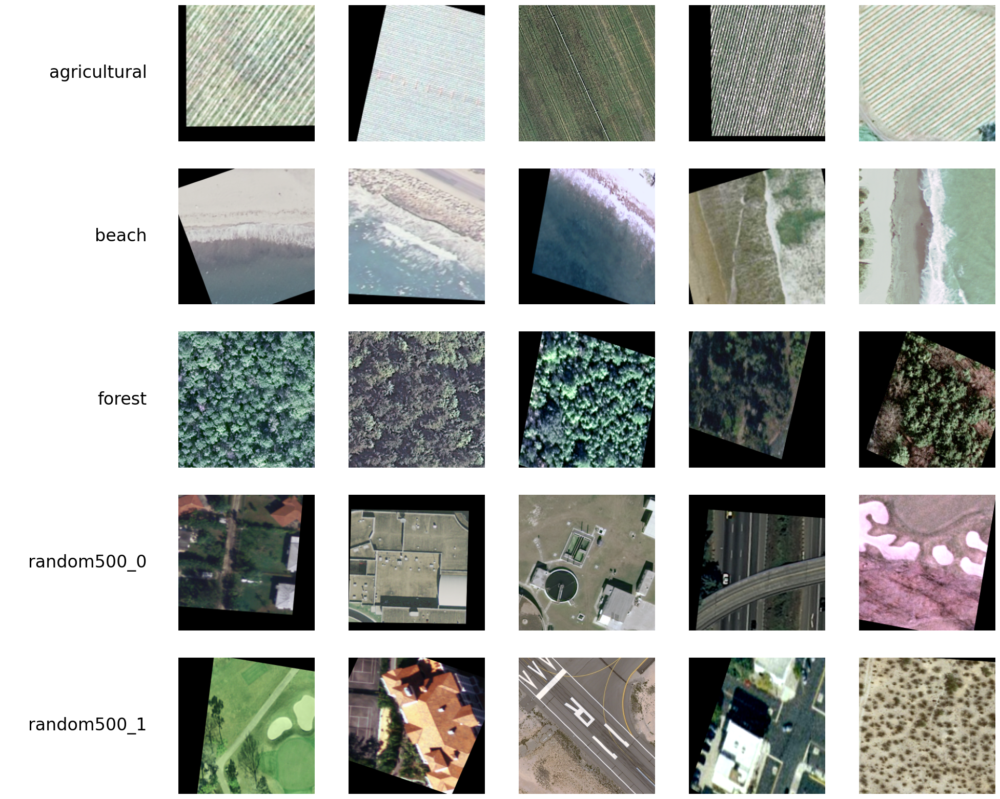

In [ ]:
# Number of figures and concepts to visualize
n_figs = 5
n_concepts = 5  # Adjust this based on the number of concepts you want to visualize

# List your concepts here
concepts = [agricultural_concept, beach_concept, forest_concept, random_0_concept, random_1_concept]

# Prepare the figure and axes
fig, axs = plt.subplots(n_concepts, n_figs + 1, figsize=(25, 4 * n_concepts))

# Iterate over each concept and its corresponding subplot row
for c, concept in enumerate(concepts):
    # Use the appropriate path based on whether the concept is random or not
    if 'random' in concept.name:
        concept_path = os.path.join("/content/random", concept.name) + "/"
    else:
        concept_path = os.path.join(concept_dir, concept.name) + "/"

    img_files = glob.glob(concept_path + '*')

    for i, img_file in enumerate(img_files[:n_figs + 1]):
        if os.path.isfile(img_file):
            if i == 0:
                axs[c, i].text(1.0, 0.5, str(concept.name), ha='right', va='center', family='sans-serif', size=24)
            else:
                img = plt.imread(img_file)
                axs[c, i].imshow(img)

            axs[c, i].axis('off')

# Display the plots
plt.show()


## Computing TCAV Scores

### Setup

In [ ]:
# Print the model to get layer name(s)
print(model_loaded)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [ ]:
# Set layer(s) to extract CAVs from
layer = ['layer1', 'layer2', 'layer3', 'layer4']

# Set up TCAV
mytcav = TCAV(model=model_loaded,
              layers=layer,
              layer_attr_method=LayerIntegratedGradients(model_loaded, None, multiply_by_inputs=False))


/usr/local/lib/python3.10/dist-packages/captum/concept/_utils/classifier.py:130: UserWarning: Using default classifier for TCAV which keeps input both train and test datasets in the memory. Consider defining your own classifier that doesn't rely heavily on memory, for large number of concepts, by extending `Classifer` abstract class
  warnings.warn(


In [ ]:
# Check which index belongs to which class name of the wildfire classification
dataset = datasets.ImageFolder(root=train_dir)
class_to_idx = dataset.class_to_idx
print(class_to_idx)

{'nowildfire': 0, 'wildfire': 1}


In [ ]:
# Set Wildfire class index
wildfire_ind = 1

### Define experimantal sets for CAV

In [ ]:
# Define the experimental set with target concepts paired with random concepts
# to test significance against
experimental_set_rand = [
    [agricultural_concept, random_0_concept],
    [agricultural_concept, random_1_concept],
    [beach_concept, random_0_concept],
    [beach_concept, random_1_concept],
    [forest_concept, random_0_concept],
    [forest_concept, random_1_concept]
    # Add more pairs if desired, e.g., freeway_concept, river_concept, etc.
]

### Unimportant?

Now, let's load sample images from imagenet. The goal is to test how sensitive model predictions are to predefined concepts such as 'striped' when predicting 'zebra' class.

Please, download zebra images and place them under `data/tcav/image/imagenet/zebra` folder in advance before running the cell below. For our experiments we used 50 different zebra images from imagenet dataset.


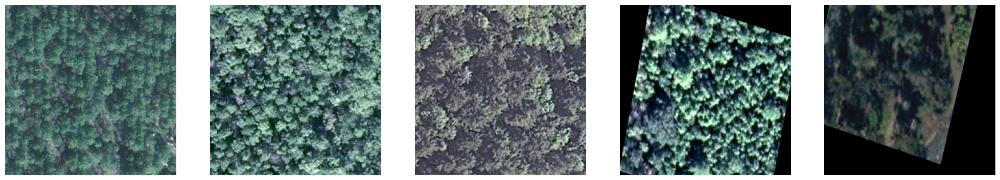

In [ ]:
# Visualise images of concept of interest
#concept_name = 'agricultural'
concept_name = 'forest'
concept_folder = os.path.join(concept_dir, concept_name)

# Load image filenames (adjusted to load any image type)
image_files = glob.glob(os.path.join(concept_folder, '*.*'))

# Load and plot a few images
fig, axs = plt.subplots(1, min(len(image_files), 5), figsize=(25, 5))

for i in range(min(len(image_files), 5)):
    img = plt.imread(image_files[i])
    axs[i].imshow(img)
    axs[i].axis('off')

plt.show()

### Load the class images

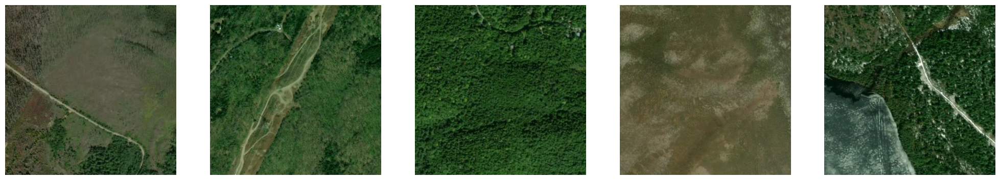

In [ ]:
# Load the images for class of interest (wildfire) and visualize the ensure correct behavior
wildfire_imgs = load_image_tensors('wildfire', root_path="/content/sampled_classes", apply_transform=False)

fig, axs = plt.subplots(1, 5, figsize = (25, 5))
axs[0].imshow(wildfire_imgs[40])
axs[1].imshow(wildfire_imgs[41])
axs[2].imshow(wildfire_imgs[34])
axs[3].imshow(wildfire_imgs[31])
axs[4].imshow(wildfire_imgs[30])

axs[0].axis('off')
axs[1].axis('off')
axs[2].axis('off')
axs[3].axis('off')
axs[4].axis('off')

plt.show()


In [ ]:
# Convert wildfire images to tensors
wildfire_tensors = torch.stack([transform(img) for img in wildfire_imgs])

### Calculate the TCAV scores

In [ ]:
# Calculate the TCAV scores
tcav_scores_w_random = mytcav.interpret(inputs=wildfire_tensors,
                                        experimental_sets=experimental_set_rand,
                                        target=wildfire_ind,
                                        n_steps=5,
                                       )
#tcav_scores_w_random
print(tcav_scores_w_random)

/usr/local/lib/python3.10/dist-packages/captum/_utils/av.py:80: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  av = torch.load(fl)
/usr/local/lib/python3.10/dist-packages/cap

defaultdict(<function TCAV.interpret.<locals>.<lambda> at 0x785e84743be0>, {'0-3': defaultdict(None, {'layer1': {'sign_count': tensor([0., 1.]), 'magnitude': tensor([-0.0074,  0.0074])}, 'layer2': {'sign_count': tensor([0., 1.]), 'magnitude': tensor([-0.0078,  0.0078])}, 'layer3': {'sign_count': tensor([0., 1.]), 'magnitude': tensor([-0.0039,  0.0039])}, 'layer4': {'sign_count': tensor([1., 0.]), 'magnitude': tensor([ 0.0037, -0.0037])}}), '0-4': defaultdict(None, {'layer1': {'sign_count': tensor([0., 1.]), 'magnitude': tensor([-0.0075,  0.0075])}, 'layer2': {'sign_count': tensor([0., 1.]), 'magnitude': tensor([-0.0033,  0.0033])}, 'layer3': {'sign_count': tensor([0., 1.]), 'magnitude': tensor([-0.0045,  0.0045])}, 'layer4': {'sign_count': tensor([0., 1.]), 'magnitude': tensor([-0.0051,  0.0051])}}), '1-3': defaultdict(None, {'layer1': {'sign_count': tensor([0., 1.]), 'magnitude': tensor([-0.0087,  0.0087])}, 'layer2': {'sign_count': tensor([0., 1.]), 'magnitude': tensor([-0.0050,  0.0

### Visualize the results

In [ ]:
#Auxiliary functions for visualizing of TCAV score
def format_float(f):
    return float('{:.3f}'.format(f) if abs(f) >= 0.0005 else '{:.3e}'.format(f))

def plot_tcav_scores(experimental_sets, tcav_scores, layers):
    fig, ax = plt.subplots(1, len(experimental_sets), figsize=(25, 7))

    barWidth = 1 / (len(experimental_sets[0]) + 1)

    for idx_es, concepts in enumerate(experimental_sets):
        concepts_key = concepts_to_str(concepts)
        pos = [np.arange(len(layers))]
        for i in range(1, len(concepts)):
            pos.append([(x + barWidth) for x in pos[i-1]])

        _ax = (ax[idx_es] if len(experimental_sets) > 1 else ax)
        for i in range(len(concepts)):
            val = [format_float(scores['sign_count'][i]) for layer, scores in tcav_scores[concepts_key].items()]
            # Print the shape and type of `val` for debugging
            print(f"Concept: {concepts[i].name}")
            print(f"Values: {val}")
            print(f"Type of val: {type(val)}")
            print(f"Length of val: {len(val)}\n")

            _ax.bar(pos[i], val, width=barWidth, edgecolor='white', label=concepts[i].name)

        # Add xticks on the middle of the group bars
        _ax.set_xlabel('Set {}'.format(str(idx_es)), fontweight='bold', fontsize=16)
        _ax.set_xticks([r + 0.3 * barWidth for r in range(len(layers))])
        _ax.set_xticklabels(layers, fontsize=16)

        # Create legend & Show graphic
        _ax.legend(fontsize=16)

    plt.show()


Concept: agricultural
Values: [0.0, 0.0, 0.0, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_0
Values: [1.0, 1.0, 1.0, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: agricultural
Values: [0.0, 0.0, 0.0, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_1
Values: [1.0, 1.0, 1.0, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: beach
Values: [0.0, 0.0, 0.0, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_0
Values: [1.0, 1.0, 1.0, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: beach
Values: [0.0, 0.0, 0.0, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_1
Values: [1.0, 1.0, 1.0, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: forest
Values: [1.0, 1.0, 1.0, 1.0]
Type of val: <class 'list'>
Length of val: 4

Concept: random500_0
Values: [0.0, 0.0, 0.0, 0.0]
Type of val: <class 'list'>
Length of val: 4

Concept: forest
Values: [1.0, 1.0, 1.0, 0.0]
Type of va

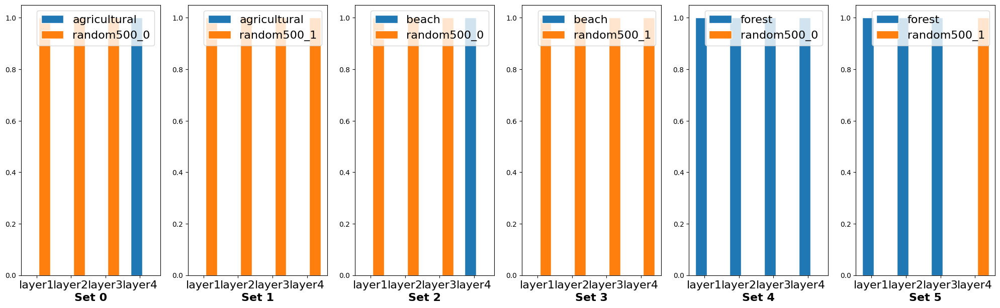

In [ ]:
# Plot the scores with the defined functions
plot_tcav_scores(experimental_set_rand, tcav_scores_w_random, layer)

In [ ]:
# Investigate the detailed scores
for concept_pair, layers_dict in tcav_scores_w_random.items():
    print(f"Concept Pair: {concept_pair}")
    for layer, scores in layers_dict.items():
        print(f"  Layer: {layer}")
        print(f"    Sign Count: {scores['sign_count']}")
        print(f"    Magnitude: {scores['magnitude']}")

Concept Pair: 0-3
  Layer: layer1
    Sign Count: tensor([0., 1.])
    Magnitude: tensor([-0.0074,  0.0074])
  Layer: layer2
    Sign Count: tensor([0., 1.])
    Magnitude: tensor([-0.0078,  0.0078])
  Layer: layer3
    Sign Count: tensor([0., 1.])
    Magnitude: tensor([-0.0039,  0.0039])
  Layer: layer4
    Sign Count: tensor([1., 0.])
    Magnitude: tensor([ 0.0037, -0.0037])
Concept Pair: 0-4
  Layer: layer1
    Sign Count: tensor([0., 1.])
    Magnitude: tensor([-0.0075,  0.0075])
  Layer: layer2
    Sign Count: tensor([0., 1.])
    Magnitude: tensor([-0.0033,  0.0033])
  Layer: layer3
    Sign Count: tensor([0., 1.])
    Magnitude: tensor([-0.0045,  0.0045])
  Layer: layer4
    Sign Count: tensor([0., 1.])
    Magnitude: tensor([-0.0051,  0.0051])
Concept Pair: 1-3
  Layer: layer1
    Sign Count: tensor([0., 1.])
    Magnitude: tensor([-0.0087,  0.0087])
  Layer: layer2
    Sign Count: tensor([0., 1.])
    Magnitude: tensor([-0.0050,  0.0050])
  Layer: layer3
    Sign Count: tens

### Snippets from tutorial: multiple concepts

Now, let's compute TCAV scores for a different experimental set that contains three different specific concepts such as `striped`, `zigzagged` and `dotted`.

In [ ]:
experimental_set_zig_dot = [[stripes_concept, zigzagged_concept, dotted_concept]]


In [ ]:

tcav_scores_w_zig_dot = mytcav.interpret(inputs=zebra_tensors,
                                         experimental_sets=experimental_set_zig_dot,
                                         target=zebra_ind,
                                         n_steps=5)


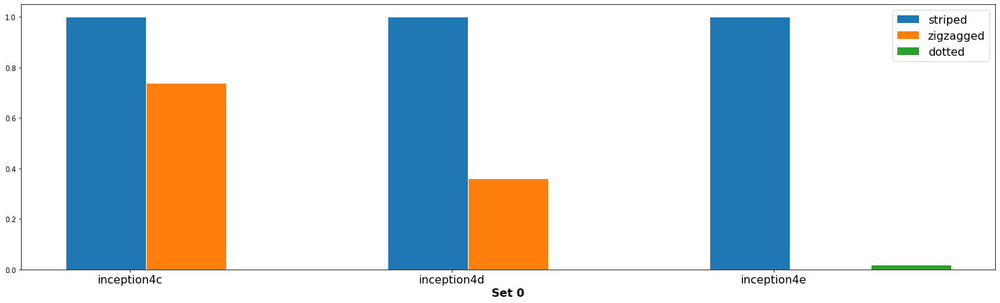

In [ ]:
plot_tcav_scores(experimental_set_zig_dot, tcav_scores_w_zig_dot)

Similar to the previous case in this experiment as well we observe that `striped` concept has very high TCAV scores across all  three layers compared to `zigzagged` and `dotted`. This means that the `striped` concept is an essential concept in predicting `zebra`.  

## Statistical significance testing of concepts

In [ ]:
print(scores)

defaultdict(<function TCAV.interpret.<locals>.<lambda> at 0x7f85783f3520>, {'2-3': defaultdict(None, {'layer1': {'sign_count': tensor([0.8680, 0.1320]), 'magnitude': tensor([ 0.1718, -0.1718])}, 'layer2': {'sign_count': tensor([0.8400, 0.1600]), 'magnitude': tensor([ 0.0374, -0.0374])}, 'layer3': {'sign_count': tensor([0.3660, 0.6340]), 'magnitude': tensor([-0.0190,  0.0190])}, 'layer4': {'sign_count': tensor([1., 0.]), 'magnitude': tensor([ 0.2151, -0.2151])}}), '2-4': defaultdict(None, {'layer1': {'sign_count': tensor([0.9440, 0.0560]), 'magnitude': tensor([ 0.3296, -0.3296])}, 'layer2': {'sign_count': tensor([0.9620, 0.0380]), 'magnitude': tensor([ 0.1354, -0.1354])}, 'layer3': {'sign_count': tensor([0.6940, 0.3060]), 'magnitude': tensor([ 0.0200, -0.0200])}, 'layer4': {'sign_count': tensor([1., 0.]), 'magnitude': tensor([ 0.1905, -0.1905])}})})


Now, let's define a convenience function for assembling the experiments together as lists of Concept objects, creating and running the TCAV:

In [ ]:
'''def assemble_scores(scores, experimental_sets, idx, score_layer, score_type):
    score_list = []
    for concepts in experimental_sets:
        score_list.append(scores["-".join([str(c.id) for c in concepts])][score_layer][score_type][idx])

    return score_list
'''

def assemble_scores(tcav_scores_w_random, experimental_sets, idx, score_layer, score_type):
    score_list = []
    for concepts in experimental_sets:
        score_list.append(tcav_scores_w_random["-".join([str(c.id) for c in concepts])][score_layer][score_type][idx])

    return score_list



In addition, it is interesting to look into the p-values of statistical significance tests for each concept. We say, that we reject null hypothesis, if the p-value for concept's TCAV scores is smaller than 0.05. This indicates that the concept is important for model prediction.

We label concept populations as overlapping if p-value > 0.05 otherwise disjoint.

In [ ]:
def get_pval(tcav_scores_w_random, experimental_set_rand, score_layer, score_type, alpha=0.05, print_ret=False):

    P1 = assemble_scores(tcav_scores_w_random, experimental_set_rand, 0, score_layer, score_type)
    P2 = assemble_scores(tcav_scores_w_random, experimental_set_rand, 1, score_layer, score_type)

    if print_ret:
        print('P1[mean, std]: ', format_float(np.mean(P1)), format_float(np.std(P1)))
        print('P2[mean, std]: ', format_float(np.mean(P2)), format_float(np.std(P2)))

    _, pval = ttest_ind(P1, P2)

    if print_ret:
        print("p-values:", format_float(pval))

    if pval < alpha:    # alpha value is 0.05 or 5%
        relation = "Disjoint"
        if print_ret:
            print("Disjoint")
    else:
        relation = "Overlap"
        if print_ret:
            print("Overlap")

    return P1, P2, format_float(pval), relation


We now run the TCAV and obtain the scores:

In [ ]:
# Run TCAV
#scores = mytcav.interpret(inputs=wildfire_tensors, experimental_sets=experimental_set_rand, target=wildfire_ind, n_steps=5)

In [ ]:
get_pval(tcav_scores_w_random, experimental_set_rand, 'layer3', 'sign_count', alpha=0.05, print_ret=True)

P1[mean, std]:  0.333 0.471
P2[mean, std]:  0.667 0.471
p-values: 0.29
Overlap


([tensor(0.), tensor(0.), tensor(0.), tensor(0.), tensor(1.), tensor(1.)],
 [tensor(1.), tensor(1.), tensor(1.), tensor(1.), tensor(0.), tensor(0.)],
 0.29,
 'Overlap')

In [ ]:
print(experimental_set_rand[4])

[Concept(2, 'forest'), Concept(3, 'random500_0')]


In [ ]:
print(enumerate(experimental_set_rand[0]))

In [ ]:
n = 4
def show_boxplots(layer, metric='sign_count'):

    def format_label_text(experimental_set_rand):
        concept_id_list = [exp.name if i == 0 else \
                             exp.name.split('_')[0] for i, exp in enumerate(experimental_set_rand[0])]
        return concept_id_list

    n_plots = 2

    fig, ax = plt.subplots(1, n_plots, figsize = (25, 7 * 1))
    fs = 18
    for i in range(n_plots):
        esl = experimental_set_rand[i * n : (i+1) * n]
        P1, P2, pval, relation = get_pval(tcav_scores_w_random, esl, layer, metric)

        ax[i].set_ylim([0, 1])
        ax[i].set_title(layer + "-" + metric + " (pval=" + str(pval) + " - " + relation + ")", fontsize=fs)
        ax[i].boxplot([P1, P2], showfliers=True)

        ax[i].set_xticklabels(format_label_text(esl), fontsize=fs)

    plt.show()

We can present the distribution of tcav scores using boxplots and the p-values indicating whether TCAV scores of those concepts are overlapping or disjoint.

In [ ]:
n = 2
def show_boxplots(layer, metric='sign_count'):

    def format_label_text(experimental_set_rand):
        #concept_id_list = [exp.name if i == 0 else \
                             #exp.name.split('_')[0] for i, exp in enumerate(experimental_set_rand[0])]
        concept_id_list = [exp.name for exp in experimental_set_rand[0]]
        #print(concept_id_list)
        return concept_id_list

    n_plots = 1

    fig, ax = plt.subplots(1, n_plots, figsize = (25, 7 * 1)) # ax is a single Axes object
    fs = 18
    # No need for a loop since there's only one plot
    esl = experimental_set_rand[0: n] # Get the first two concept sets
    P1, P2, pval, relation = get_pval(scores, esl, layer, metric)

    ax.set_ylim([0, 1]) # Access ax directly, not as ax[i]
    ax.set_title(layer + "-" + metric + " (pval=" + str(pval) + " - " + relation + ")", fontsize=fs)
    ax.boxplot([P1, P2], showfliers=True)

    ax.set_xticklabels(format_label_text(esl), fontsize=fs)

    plt.show()

Below box plots visualize the distribution of TCAV scores for two pairs of concepts in three different layers. Each layer is visualized in a separate jupyter cell.
Below diagrams show that `striped` concept has TCAV scores that are consistently high across all layers and experimental sets as apposed to `random` concept. It also shows that `striped` and `random` are disjoint populations.

When we compare the populations of two random concepts we see that the p-value is much higher, meaning that those populations overlap and we cannot reject null hypothesis anymore.

/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:531: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)
/usr/local/lib/python3.10/dist-packages/scipy/stats/_axis_nan_policy.py:531: RuntimeWarning: Precision loss occurred in moment calculation due to catastrophic cancellation. This occurs when the data are nearly identical. Results may be unreliable.
  res = hypotest_fun_out(*samples, **kwds)


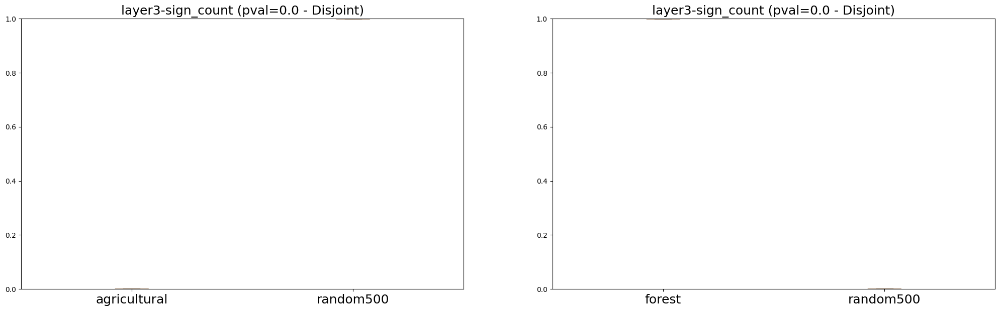

In [ ]:
show_boxplots ("layer3")

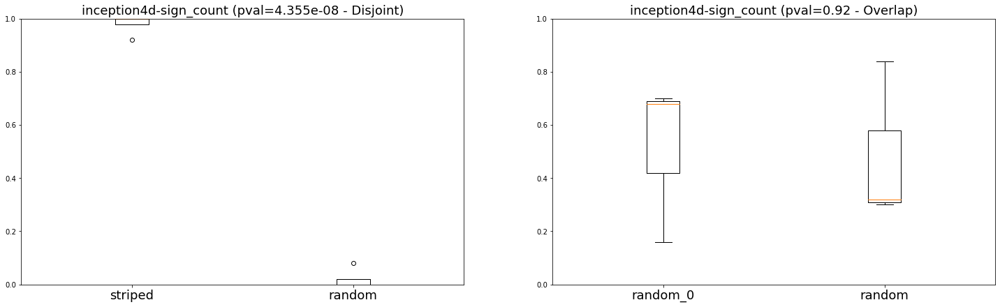

In [ ]:
show_boxplots ("inception4d")

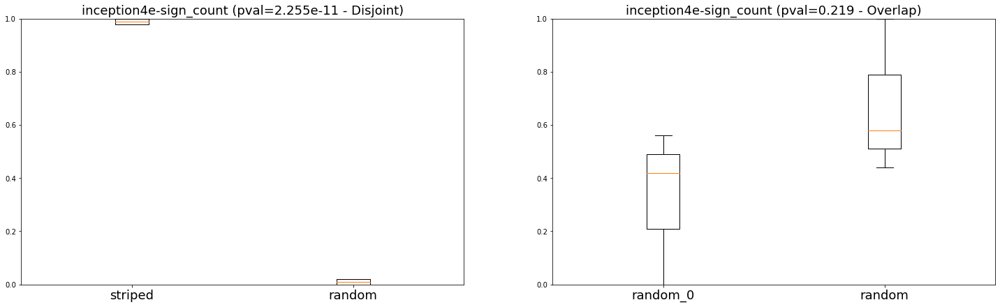

In [ ]:
show_boxplots ("inception4e")

# LIME GRAD CAM TESTS

In [ ]:
import torch
import torch.nn.functional as F

from captum.attr import visualization as viz
from captum.attr import Lime, LimeBase
from captum._utils.models.linear_model import SkLearnLinearRegression, SkLearnLasso

import os
import json
from torchvision.models import resnet18
from torchvision.datasets import VOCSegmentation
import torchvision.transforms as T
from captum.attr._core.lime import get_exp_kernel_similarity_function

from PIL import Image
import matplotlib.pyplot as plt

In [ ]:
# Modify test loader for LIME (batch size of 1)
test_loader_lime = DataLoader(test_dataset, batch_size=1, shuffle=True)


In [ ]:
# Get a single image and its label from the test_loader_lime
for img, label in test_loader_lime:
    img, label = img.to(device), label.to(device)
    break  # We only need one image for LIME


In [ ]:
# Ensure the model is in evaluation mode
model_loaded.eval()

# Forward pass through the model to get output probabilities
with torch.no_grad():
    output_probs = torch.softmax(model_loaded(img), dim=1)


In [ ]:
# Create a feature mask where each pixel is treated as a separate feature
feature_mask = torch.arange(0, img.numel()).view(img.size()).to(device)


In [ ]:
exp_eucl_distance = get_exp_kernel_similarity_function('euclidean', kernel_width=1000)

lr_lime = Lime(
    model_loaded,
    interpretable_model=SkLearnLinearRegression(),  # build-in wrapped sklearn Linear Regression
    similarity_func=exp_eucl_distance
)

In [ ]:
label_idx = output_probs.argmax().unsqueeze(0)
attrs = lr_lime.attribute(
    img.unsqueeze(0),
    target=label_idx,
    feature_mask=feature_mask.unsqueeze(0),
    n_samples=40,
    perturbations_per_eval=16,
    show_progress=True
).squeeze(0)

print('Attribution range:', attrs.min().item(), 'to', attrs.max().item())

In [ ]:
def show_attr(attr_map):
    viz.visualize_image_attr(
        attr_map.permute(1, 2, 0).numpy(),  # adjust shape to height, width, channels
        method='heat_map',
        sign='all',
        show_colorbar=True
    )

show_attr(attrs)

In [24]:
# Step 1: Modify test loader for LIME (batch size of 1)
test_loader_lime = DataLoader(test_dataset, batch_size=1, shuffle=True)

# Step 2: Extract a single image for LIME
for img, label in test_loader_lime:
    img, label = img.to(device), label.to(device)
    print(f"Image shape: {img.shape}, Label: {label}")
    break  # We only need one image for LIME

# Step 3: Generate output probabilities
model_loaded.eval()
with torch.no_grad():
    output_probs = torch.softmax(model_loaded(img), dim=1)
    print(f"Output probabilities: {output_probs}")

# Step 4: Create a feature mask
from skimage.segmentation import slic
img_np = img.squeeze(0).permute(1, 2, 0).cpu().numpy()
img_np = (img_np * [0.229, 0.224, 0.225] + [0.485, 0.456, 0.406]) * 255  # Undo normalization
img_np = img_np.astype('uint8')
print(f"Image shape after undo normalization: {img_np.shape}")

feature_mask = torch.tensor(slic(img_np, n_segments=50, compactness=10, sigma=1)).unsqueeze(0).to(device)
print(f"Feature mask shape: {feature_mask.shape}, Min: {feature_mask.min()}, Max: {feature_mask.max()}")

# Step 5: Define output label index
label_idx = output_probs.argmax(dim=1).unsqueeze(0)
print(f"Label index for LIME target: {label_idx}")

# Step 6: Generate LIME attributions
from captum.attr._core.lime import get_exp_kernel_similarity_function, Lime
from captum.attr import visualization as viz
from sklearn.linear_model import LinearRegression as SkLearnLinearRegression

# Create similarity function
exp_eucl_distance = get_exp_kernel_similarity_function('euclidean', kernel_width=1000)

# Initialize LIME
lr_lime = Lime(
    model_loaded,
    interpretable_model=SkLearnLinearRegression(),
    similarity_func=exp_eucl_distance
)

# Diagnostic print to check LIME setup
print("LIME instance created successfully.")

# Generate LIME attributions
attrs = lr_lime.attribute(
    img,
    target=label_idx,
    feature_mask=feature_mask,
    n_samples=40,
    perturbations_per_eval=16,
    show_progress=True
).squeeze(0)

# Diagnostic print for attributions
print(f"LIME attributions shape: {attrs.shape}, Min: {attrs.min()}, Max: {attrs.max()}")

# Step 7: Visualize the attributions
def show_attr(attr_map):
    viz.visualize_image_attr(
        attr_map.permute(1, 2, 0).cpu().numpy(),
        method='heat_map',
        sign='all',
        show_colorbar=True
    )

show_attr(attrs)


Image shape: torch.Size([1, 3, 224, 224]), Label: tensor([0])
Output probabilities: tensor([[0.9231, 0.0769]])
Image shape after undo normalization: (224, 224, 3)
Feature mask shape: torch.Size([1, 224, 224]), Min: 1, Max: 31
Label index for LIME target: tensor([[0]])
LIME instance created successfully.


Lime attribution:   0%|          | 0/3 [00:00<?, ?it/s]

TypeError: LinearRegression.fit() missing 1 required positional argument: 'y'

# GradCAM

In [27]:
! pip install torchcam


In [28]:
import torch
import torchvision.transforms as transforms
from torchcam.methods import GradCAM
from torchcam.utils import overlay_mask
from torchvision.io import read_image
from torchvision.models import resnet50
import matplotlib.pyplot as plt

In [29]:
cam_extractor = GradCAM(model_loaded, target_layer='layer4')

In [30]:
test_loader_lime = DataLoader(test_dataset, batch_size=1, shuffle=True)

# Step 2: Extract a single image for LIME
for img, label in test_loader_lime:
    img, label = img.to(device), label.to(device)
    print(f"Image shape: {img.shape}, Label: {label}")
    break  # We only need one image for LIME

Image shape: torch.Size([1, 3, 224, 224]), Label: tensor([1])


In [31]:
print(f"Image shape: {img.shape}")


Image shape: torch.Size([1, 3, 224, 224])


In [32]:
img = img.to(device)

In [33]:
# Step 4: Forward pass to get the model's output
output = model_loaded(img)
pred_class = output.argmax(dim=1).item()

In [34]:
activation_map = cam_extractor(pred_class, output)

In [36]:
# Step 1: Ensure activation_map is a tensor, not a list
if isinstance(activation_map, list):
    # If it's a list, assume we want the first element (adjust this if your case is different)
    activation_map = activation_map[0]

# Step 2: Convert the activation map to a heatmap and overlay it on the original image
heatmap = overlay_mask(
    transforms.ToPILImage()(img.squeeze(0).cpu()),
    transforms.ToPILImage()(activation_map.squeeze(0).cpu()),
    alpha=0.5
)

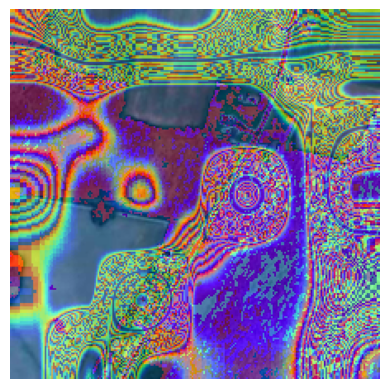

In [37]:
plt.imshow(heatmap)
plt.axis('off')
plt.show()

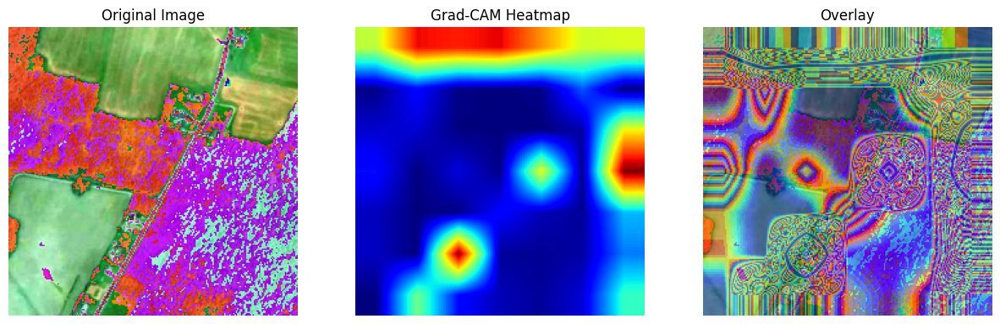

In [39]:
import cv2

# Ensure activation_map is a tensor, not a list
if isinstance(activation_map, list):
    activation_map = activation_map[0]

# Resize the activation map to the size of the original image
activation_map_resized = cv2.resize(activation_map.squeeze(0).cpu().numpy(),
                                    (img.shape[2], img.shape[3]))

# Convert resized activation map back to tensor
activation_map_resized = torch.tensor(activation_map_resized).unsqueeze(0)

# Convert to PIL Images for display
original_image = transforms.ToPILImage()(img.squeeze(0).cpu())
heatmap = transforms.ToPILImage()(activation_map_resized)
overlay = overlay_mask(original_image, heatmap, alpha=0.5)

# Plotting the original image, Grad-CAM heatmap, and the overlay
fig, ax = plt.subplots(1, 3, figsize=(15, 5))

# Original Image
ax[0].imshow(original_image)
ax[0].axis('off')
ax[0].set_title('Original Image')

# Grad-CAM Heatmap
ax[1].imshow(heatmap, cmap='jet')
ax[1].axis('off')
ax[1].set_title('Grad-CAM Heatmap')

# Overlay of Heatmap on Image
ax[2].imshow(overlay)
ax[2].axis('off')
ax[2].set_title('Overlay')

plt.show()


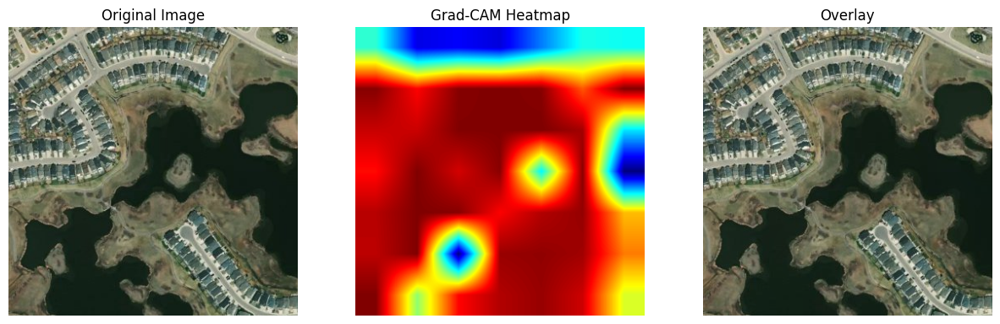

In [40]:
import matplotlib.pyplot as plt
import numpy as np
import cv2
import torch
from torchvision import transforms

# Step 1: Load the image using plt.imread
image_file = '/content/wildfire-prediction-dataset/test/nowildfire/-113.91777,50.901087.jpg'  # Replace with your actual image path
original_img = plt.imread(image_file)

# Step 2: Preprocess the image for the model (resize, convert to tensor, normalize)
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# Convert the original image to PIL and then apply the transforms
img_tensor = transform(transforms.ToPILImage()(original_img))

# Add batch dimension
img_tensor = img_tensor.unsqueeze(0).to(device)

# Step 3: Generate the Grad-CAM heatmap
# (This assumes you have already set up your Grad-CAM mechanism and generated `activation_map`)
# Ensure activation_map is a tensor, not a list
if isinstance(activation_map, list):
    activation_map = activation_map[0]

# Resize the activation map to the size of the original image
activation_map_resized = cv2.resize(activation_map.squeeze(0).cpu().numpy(),
                                    (original_img.shape[1], original_img.shape[0]))

# Normalize the activation map (optional)
activation_map_resized = (activation_map_resized - activation_map_resized.min()) / \
                         (activation_map_resized.max() - activation_map_resized.min())

# Convert the resized activation map to a heatmap (using OpenCV colormap)
heatmap = cv2.applyColorMap(np.uint8(255 * activation_map_resized), cv2.COLORMAP_JET)

# Convert heatmap to RGB format and normalize
heatmap = np.float32(heatmap) / 255

# Step 4: Overlay the heatmap onto the original image
overlay = heatmap + np.float32(original_img)
overlay = overlay / np.max(overlay)

# Step 5: Plot the original image, heatmap, and overlay
fig, ax = plt.subplots(1, 3, figsize=(15, 5))

# Original Image
ax[0].imshow(original_img)
ax[0].axis('off')
ax[0].set_title('Original Image')

# Grad-CAM Heatmap
ax[1].imshow(heatmap)
ax[1].axis('off')
ax[1].set_title('Grad-CAM Heatmap')

# Overlay of Heatmap on Image
ax[2].imshow(overlay)
ax[2].axis('off')
ax[2].set_title('Overlay')

plt.show()


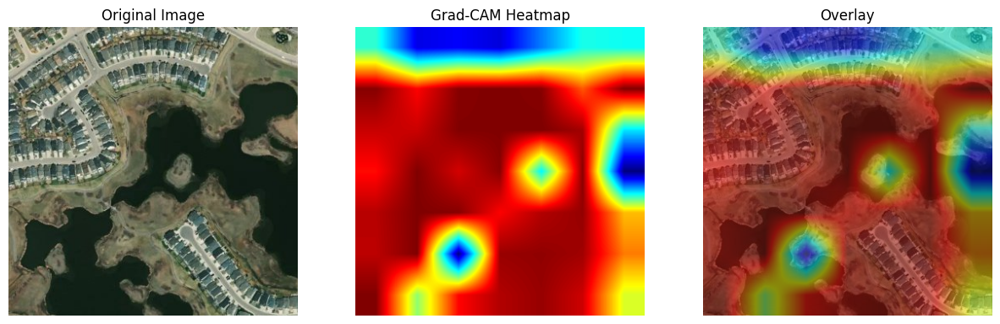

In [41]:
import matplotlib.pyplot as plt
import numpy as np
import cv2
import torch
from torchvision import transforms

# Step 1: Load the image using plt.imread
image_file = '/content/wildfire-prediction-dataset/test/nowildfire/-113.91777,50.901087.jpg'  # Replace with your actual image path
original_img = plt.imread(image_file)

# Step 2: Preprocess the image for the model (resize, convert to tensor, normalize)
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# Convert the original image to PIL and then apply the transforms
img_tensor = transform(transforms.ToPILImage()(original_img))

# Add batch dimension
img_tensor = img_tensor.unsqueeze(0).to(device)

# Step 3: Generate the Grad-CAM heatmap
# Ensure activation_map is a tensor, not a list
if isinstance(activation_map, list):
    activation_map = activation_map[0]

# Resize the activation map to the size of the original image
activation_map_resized = cv2.resize(activation_map.squeeze(0).cpu().numpy(),
                                    (original_img.shape[1], original_img.shape[0]))

# Normalize the activation map (optional)
activation_map_resized = (activation_map_resized - activation_map_resized.min()) / \
                         (activation_map_resized.max() - activation_map_resized.min())

# Convert the resized activation map to a heatmap (using OpenCV colormap)
heatmap = cv2.applyColorMap(np.uint8(255 * activation_map_resized), cv2.COLORMAP_JET)

# Convert heatmap to RGB format and normalize
heatmap = np.float32(heatmap) / 255

# Step 4: Convert original image to float32 for blending
original_img_float = np.float32(original_img) / 255

# Step 5: Overlay the heatmap onto the original image
# Use different blending techniques if needed; here we're using a weighted sum
overlay = heatmap + original_img_float
overlay = overlay / np.max(overlay)

# Step 6: Plot the original image, heatmap, and overlay
fig, ax = plt.subplots(1, 3, figsize=(15, 5))

# Original Image
ax[0].imshow(original_img)
ax[0].axis('off')
ax[0].set_title('Original Image')

# Grad-CAM Heatmap
ax[1].imshow(heatmap)
ax[1].axis('off')
ax[1].set_title('Grad-CAM Heatmap')

# Overlay of Heatmap on Image
ax[2].imshow(overlay)
ax[2].axis('off')
ax[2].set_title('Overlay')

plt.show()


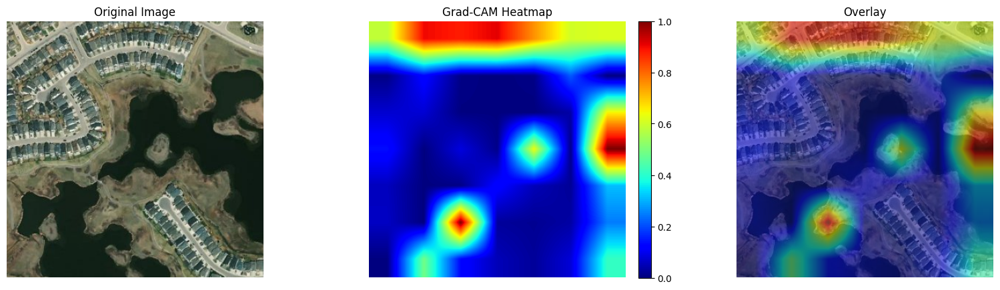

In [43]:
import matplotlib.pyplot as plt
import numpy as np
import torch
from torchvision import transforms

# Step 1: Load the image using plt.imread
image_file = '/content/wildfire-prediction-dataset/test/nowildfire/-113.91777,50.901087.jpg'  # Replace with your actual image path
original_img = plt.imread(image_file)

# Step 2: Preprocess the image for the model (resize, convert to tensor, normalize)
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# Convert the original image to PIL and then apply the transforms
img_tensor = transform(transforms.ToPILImage()(original_img))

# Add batch dimension
img_tensor = img_tensor.unsqueeze(0).to(device)

# Step 3: Generate the Grad-CAM heatmap
# Ensure activation_map is a tensor, not a list
if isinstance(activation_map, list):
    activation_map = activation_map[0]

# Resize the activation map to the size of the original image
activation_map_resized = cv2.resize(activation_map.squeeze(0).cpu().numpy(),
                                    (original_img.shape[1], original_img.shape[0]))

# Normalize the activation map (optional)
activation_map_resized = (activation_map_resized - activation_map_resized.min()) / \
                         (activation_map_resized.max() - activation_map_resized.min())

# Use Matplotlib to create the heatmap to ensure consistency in color
heatmap = plt.get_cmap('jet')(activation_map_resized)

# Remove the alpha channel (since Matplotlib adds it by default)
heatmap = heatmap[..., :3]

# Convert original image to float32 for blending
original_img_float = np.float32(original_img) / 255

# Overlay the heatmap onto the original image
overlay = heatmap + original_img_float
overlay = overlay / np.max(overlay)

# Plotting the original image, heatmap, and overlay with a color legend
fig, ax = plt.subplots(1, 3, figsize=(20, 5))

# Original Image
ax[0].imshow(original_img)
ax[0].axis('off')
ax[0].set_title('Original Image')

# Grad-CAM Heatmap
heatmap_img = ax[1].imshow(activation_map_resized, cmap='jet')
ax[1].axis('off')
ax[1].set_title('Grad-CAM Heatmap')

# Adding a colorbar (legend) for the heatmap
fig.colorbar(heatmap_img, ax=ax[1], fraction=0.046, pad=0.04)

# Overlay of Heatmap on Image
ax[2].imshow(overlay)
ax[2].axis('off')
ax[2].set_title('Overlay')

plt.show()
